# Scicomap Tutorial

Accurate data representation is of paramount importance. Frequently used color maps often introduce data distortion due to uneven color gradients, making them challenging to interpret, especially for individuals with color-vision deficiencies. One notorious example is the jet color map. Such color maps may fail to convey the complete information you intend to illustrate and, in some cases, even convey incorrect information due to artifacts. Whether you're a scientist or not, the aim is to present visual information both accurately and attractively. Additionally, it's crucial not to disregard color-vision deficiencies, which affect approximately 8% of the Caucasian male population.

## Color space
Perceptual uniformity revolves around the concept that the Euclidean distance between colors in a color space should align with human color perception distance judgments. To illustrate, if two colors, one blue and one red, are separated by a distance denoted as 'd,' they should appear as discriminable to the human eye as another pair, perhaps green and purple, also separated by the same 'd' distance. Scicomap adopts the CAM02-UCS color space, standing for Uniform Colour Space. This color space relies on three primary coordinates typically labeled as J', a', and b'. Additionally, it includes cylindrical coordinates represented as J', C', and h'. While the perceptual color space Jab closely resembles Lab, it incorporates an updated color appearance model, theoretically offering enhanced precision for discriminability measurements.

 * Lightness: also known as value or tone, is a representation of a color's brightness
 * Chroma: the intrinsic difference between a color and gray of an object
 * Hue: the degree to which a stimulus can be described as similar to or different from stimuli that are described as red, green, blue, and yellow

## Encoding information
 * Lightness J': for a scalar value, intensity. It must vary linearly with the physical quantity
 * hue h' can encode an additional physical quantity, the change of hue should be linearly proportional to the quantity. The hue h' is also ideal in making an image more attractive without interfering with the representation of pixel values.
 * chroma is less recognizable and should not be used to encode physical information

## Color map uniformization

Following the references and the theories, the uniformization is performed by

 * Making the color map linear in J'
 * Lifting the color map (making it lighter, i.e. increasing the minimal value of J')
 * Symmetrizing the chroma to avoid further artefacts
 * Avoid kinks and edges in the chroma curve
 * Bitonic symmetrization or not

## Selecting the Right Colormap
For guidance on choosing the appropriate colormap and the reasoning behind it, I recommend referring to [The Misuse of Colour in Science Communication](https://doi.org/10.1038/s41467-020-19160-7), which provides detailed explanations and insights.

<td align="left"><img src="../../pics/choosing-cmap.png" width="500"/></td>

In [1]:
import scicomap as sc
import matplotlib.pyplot as plt
import matplotlib as mpl
from scicomap.utils import _fn_with_roots

## Use with matplotlib

<class 'matplotlib.colors.ListedColormap'>


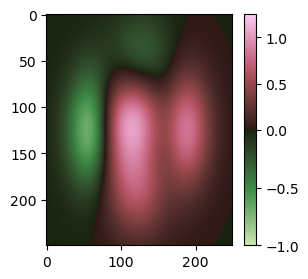

In [2]:
# load the color map
div_map = sc.ScicoDiverging(cmap='watermelon')

# correct the colormap
div_map.unif_sym_cmap(lift=15, bitonic=False, diffuse=True)

# get the fixed color map
fixed_cmap = div_map.get_mpl_color_map()
print(type(fixed_cmap))

# use it as you like
im = _fn_with_roots()
norm = mpl.colors.CenteredNorm()
divnorm = mpl.colors.TwoSlopeNorm(vmin=-1, vcenter=0, vmax=1.25)
fig = plt.figure(figsize=(3,3), facecolor="white")
ax = fig.add_subplot(1, 1, 1, facecolor="white")
pos = ax.imshow(im, cmap=fixed_cmap, aspect="auto", norm=divnorm)
fig.colorbar(pos, ax=ax);

# Never ever use the jet/rainbow color map

If you're looking for an alternative to a rainbow-like colormap, consider using the `batlow` or `rainbow-kov` color maps. However, there are better options among sequential colormaps (as discussed below).. You can compare how bad the `jet` cmap render compare to the uniform sequential cmap here under.

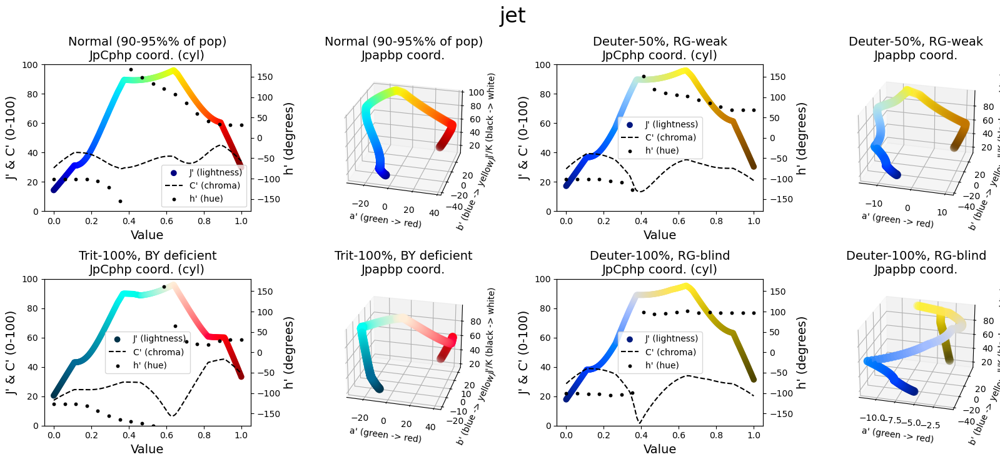

In [3]:
import scicomap as sc
import matplotlib.pyplot as plt

figsize=(16.5, 7.5)

# the thing that should not be
ugly_jet = plt.get_cmap("jet")
sc_map =  sc.ScicoMiscellaneous(cmap=ugly_jet)
f=sc_map.assess_cmap(figsize=figsize)

The rendering is heavily affected by artifacts, making it appear distorted. The pyrimad shoul appear smooth, except for the edges. The larger dark transition might help to distinguish the positive and negative regions but introduces artefacts (pyramids, second column panels). By correcting the color map, we remove the smooth dark transition by a sharp one and we "lift" the dark part to make it a bit brighter. Human eyes are more able to differentiate the lighter colors.

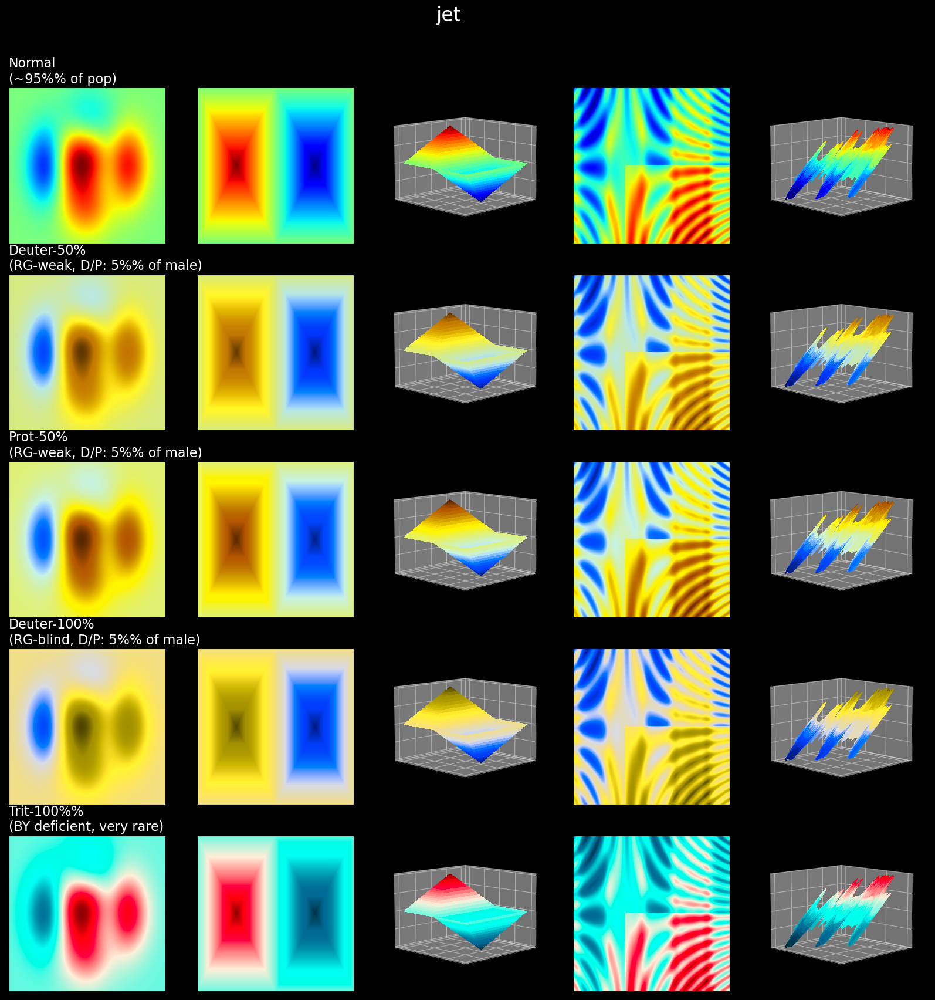

In [4]:
f = sc_map.draw_example()

## Sequential color maps
Ordered, without centric value and not periodic data. May also be suited to categorical data (without order).

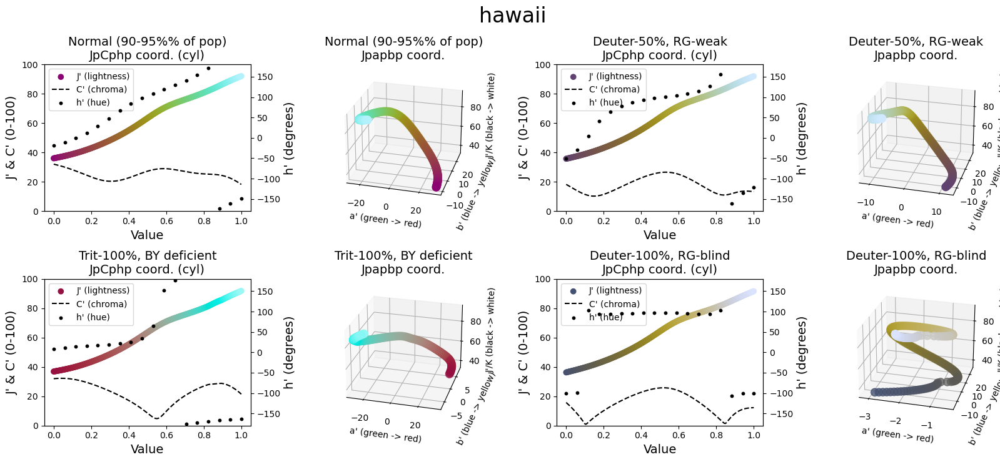

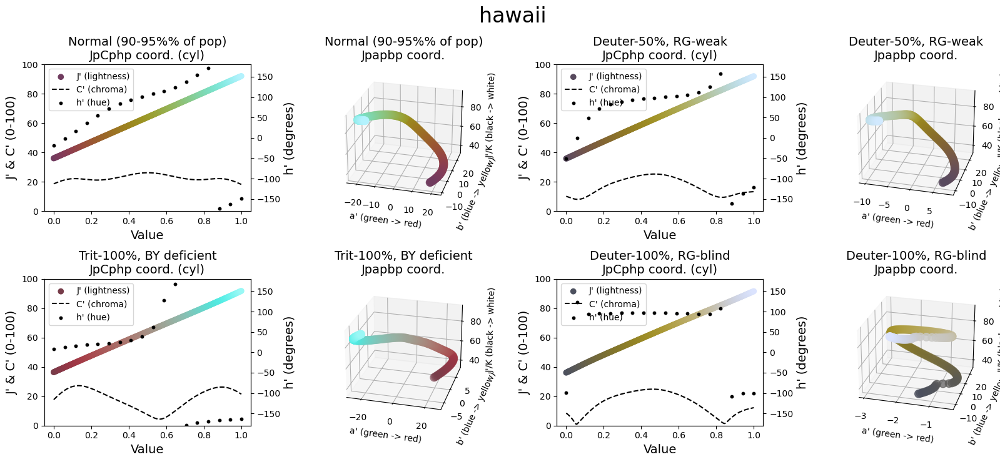

In [5]:
sc_map = sc.ScicoSequential(cmap="hawaii")
# before uniformization
f = sc_map.assess_cmap(figsize=figsize)
# after uniformization
sc_map.unif_sym_cmap(lift=None, bitonic=False, diffuse=True)
f = sc_map.assess_cmap(figsize=figsize)

In the example below, the features should be displayed naturally. For instance, when depicting the edges of a pyramid, they should appear distinct and free from any artifacts that might create a visual "staircase" effect, because the slope is physically constant.

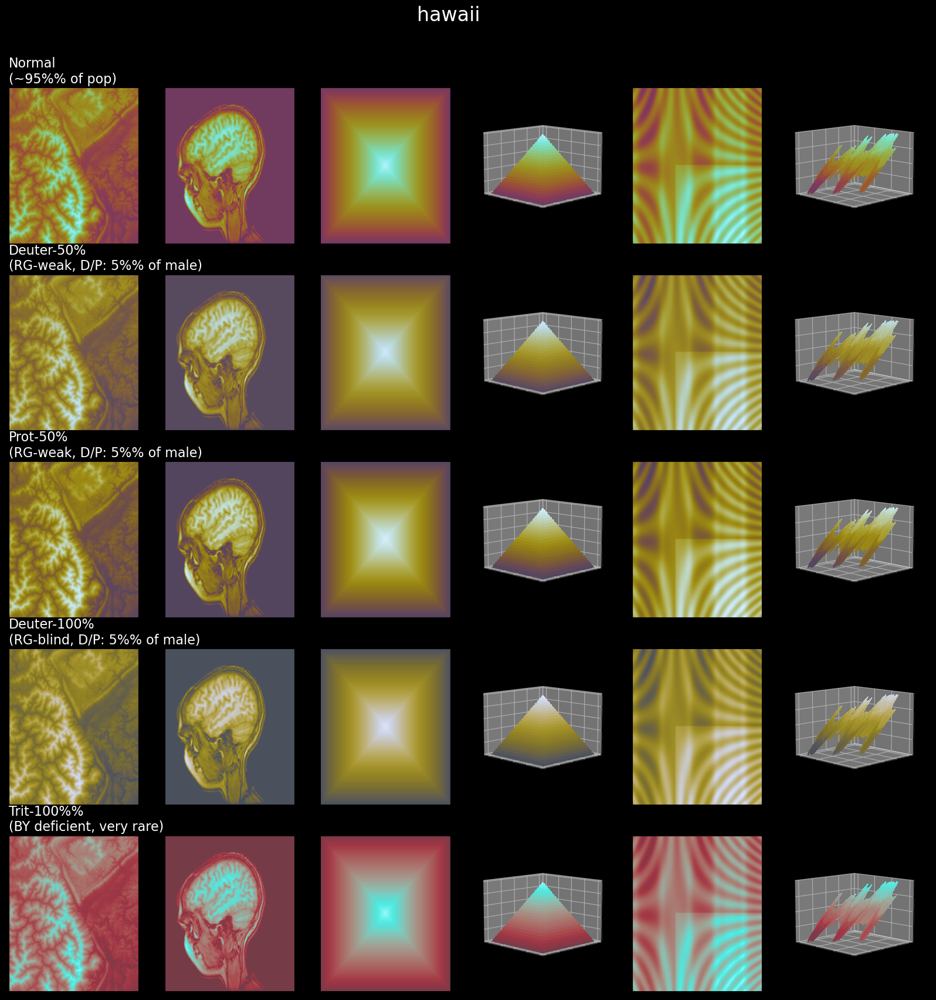

In [6]:
f = sc_map.draw_example()

## Diverging color map

Ordered, with a centric value (e.g. zero) and not periodic data.

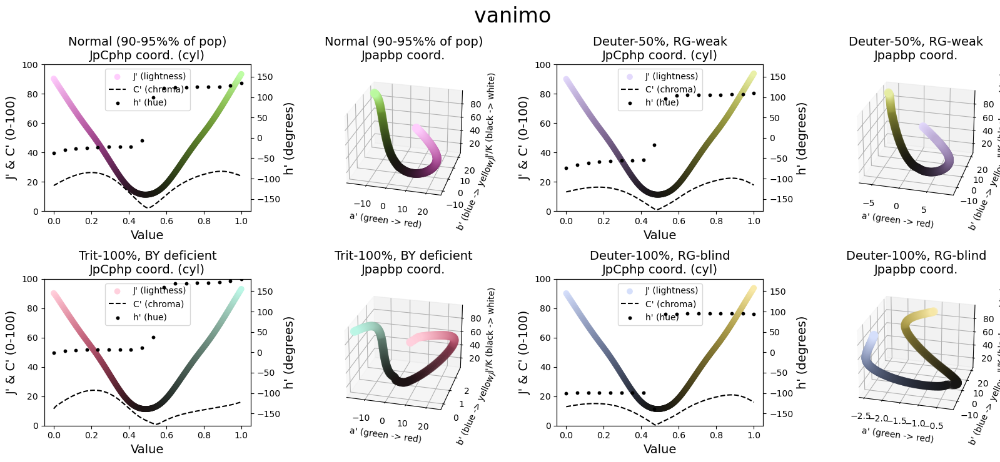

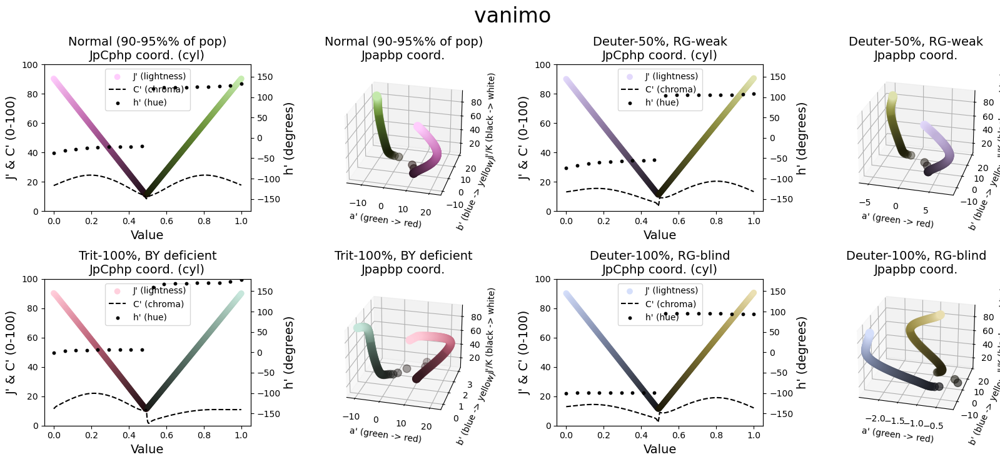

In [7]:
div_map = sc.ScicoDiverging(cmap="vanimo")

# before uniformization
f = div_map.assess_cmap(figsize=figsize)
# after uniformization
div_map.unif_sym_cmap(lift=None, bitonic=False, diffuse=True)
f = div_map.assess_cmap(figsize=figsize)

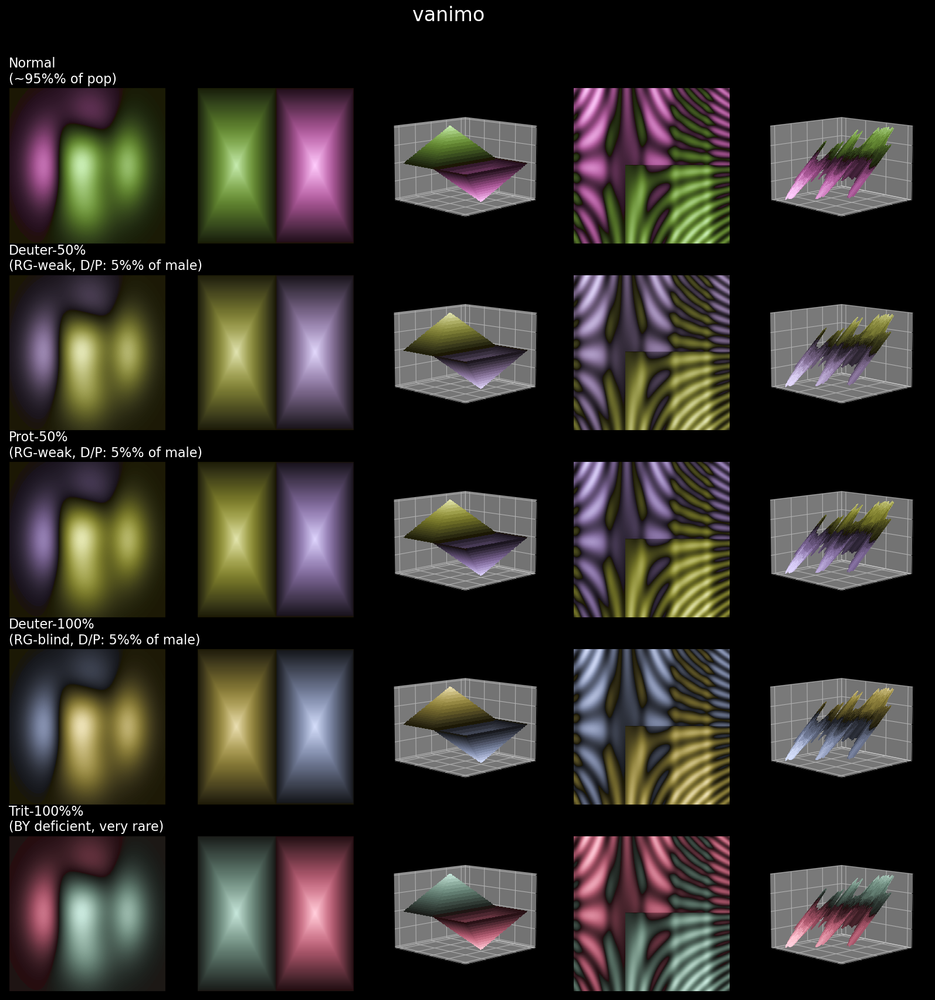

In [8]:
f = div_map.draw_example()

## Multi-sequential color map

Ordered, with centric value, two different scales and not periodic data. A common example of this concept involves two scales: one representing elevations from the ocean floor to the Earth's surface, and the other from the surface to the highest point on the planet.

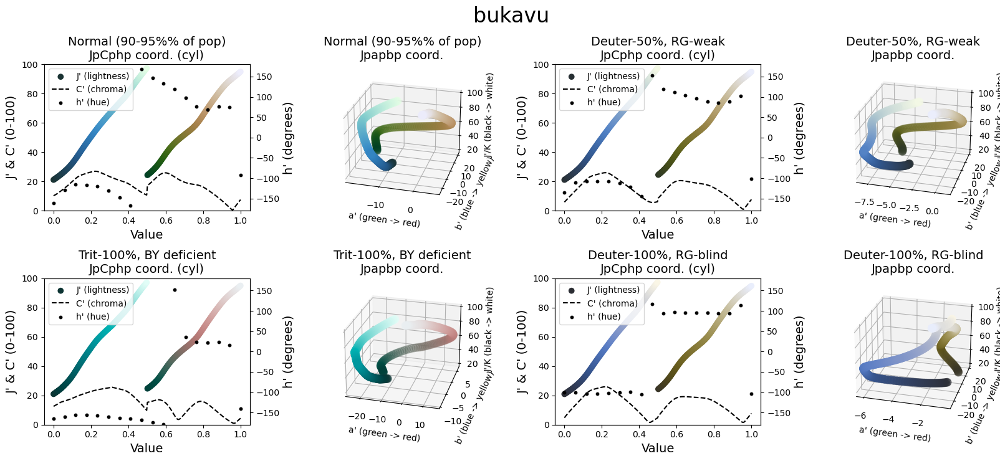

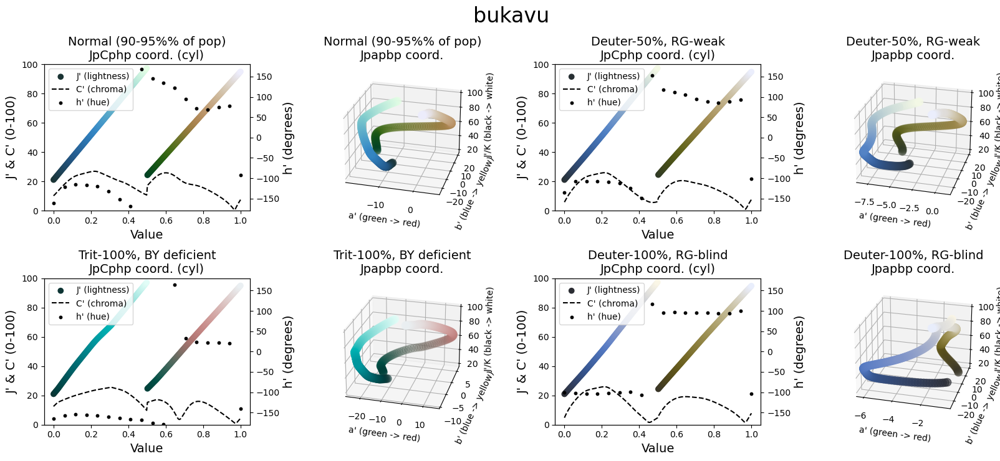

In [9]:
ms_map = sc.ScicoMultiSequential(cmap="bukavu")
f = ms_map.assess_cmap(figsize=figsize)
ms_map.uniformize_cmap(lift=None)
f = ms_map.assess_cmap(figsize=figsize)

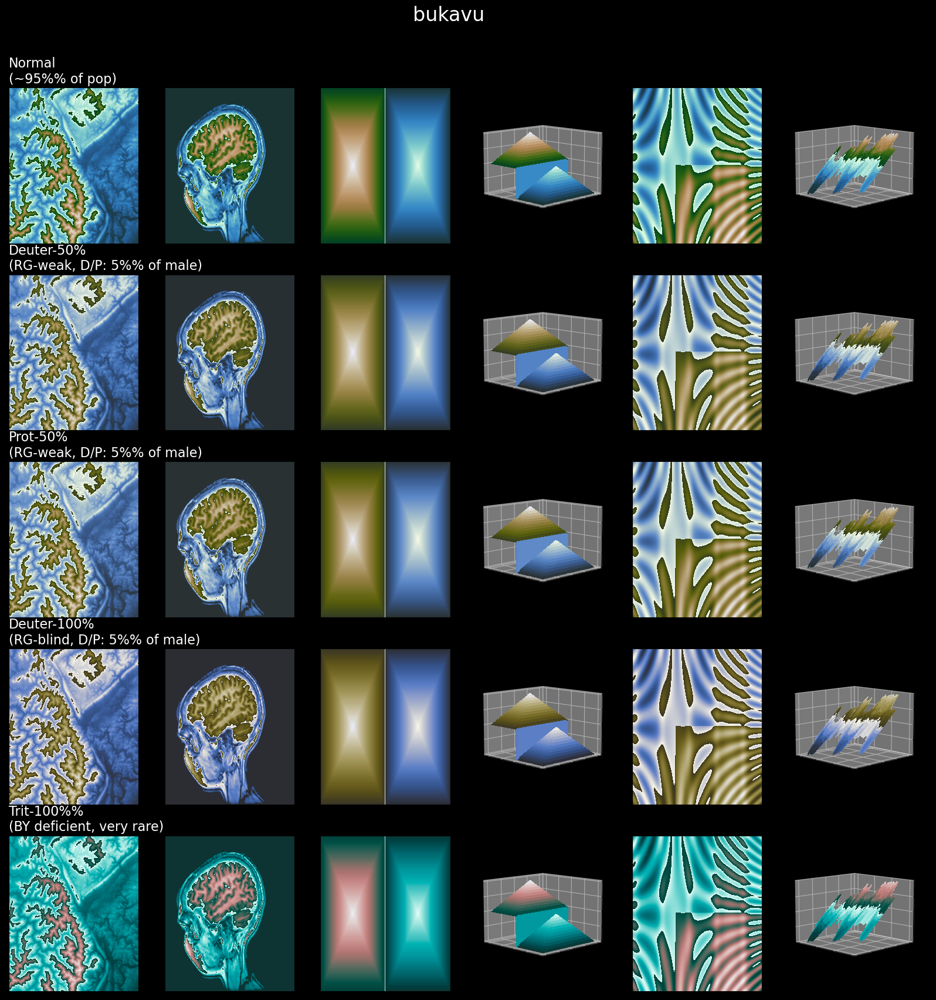

In [10]:
f = ms_map.draw_example()

## Circular color map

Ordered, without centric values and periodic, such as angles. They are especially good for complex valued functions.

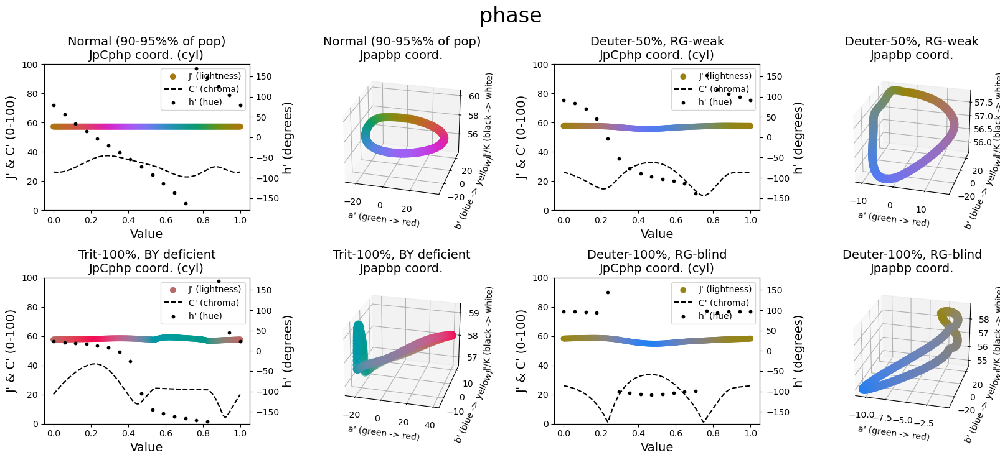

In [11]:
sc_map = sc.ScicoCircular(cmap="phase")
# not adjusted
f = sc_map.assess_cmap(figsize=figsize)

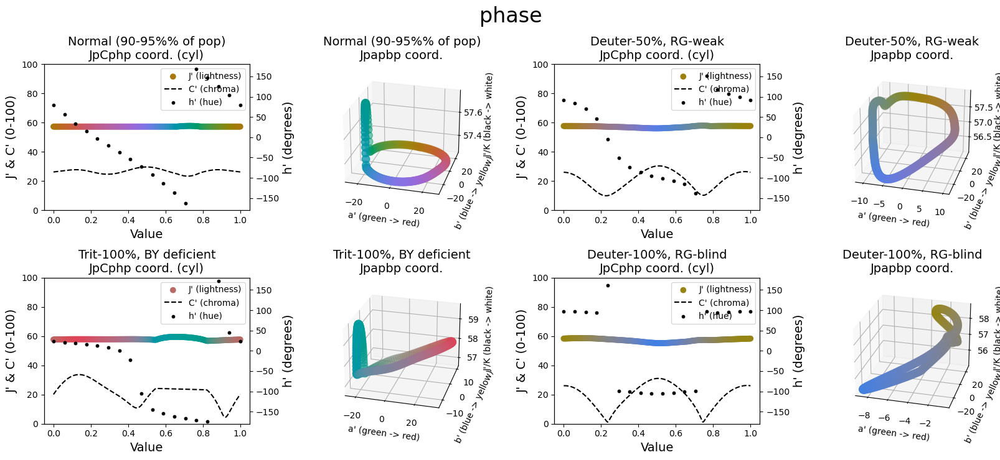

In [12]:
# adjusted
sc_map.unif_sym_cmap(lift=None, bitonic=False, diffuse=True)
f = sc_map.assess_cmap(figsize=figsize)

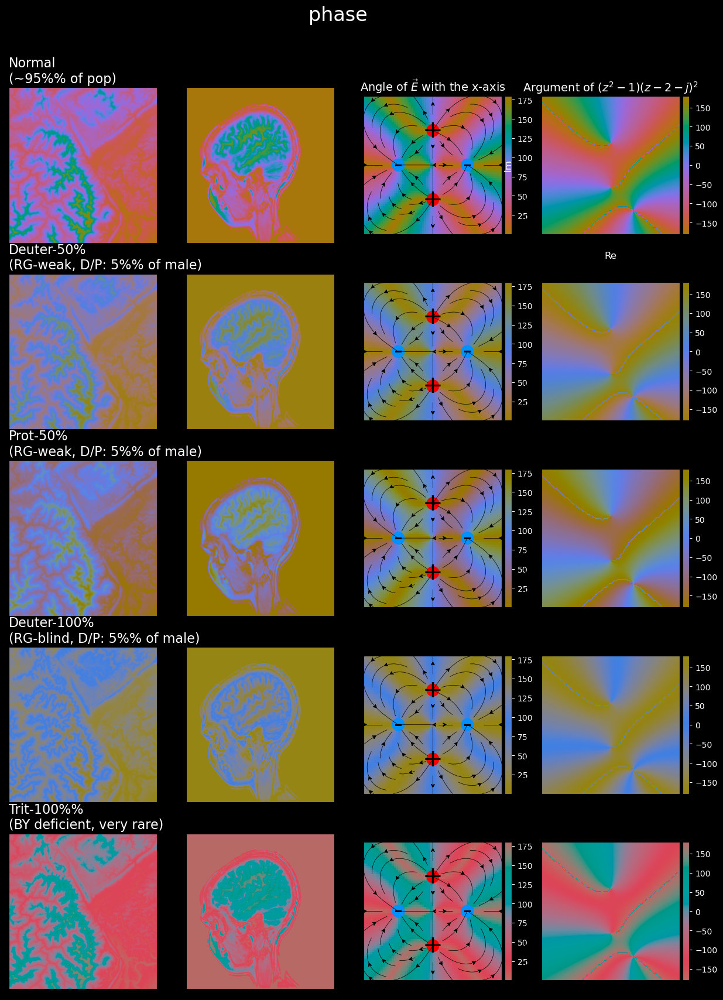

In [13]:
f = sc_map.draw_example(cblind=True, figsize=(15, 20))

## Qualitative color maps

No specific order, limited unique values, and highly distinguishable.

c:\Users\xtbury\AppData\Local\mambaforge\envs\taco\lib\site-packages\scicomap\cmath.py:820: UserWarning: The colormap glasbey type is unknown (not recognized as sequential or divergent)
Not uniformized
  warnings.warn(


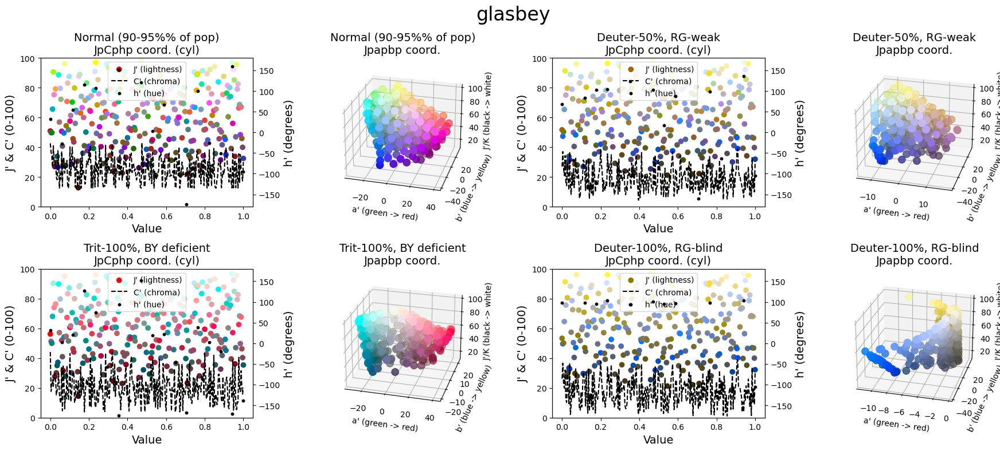

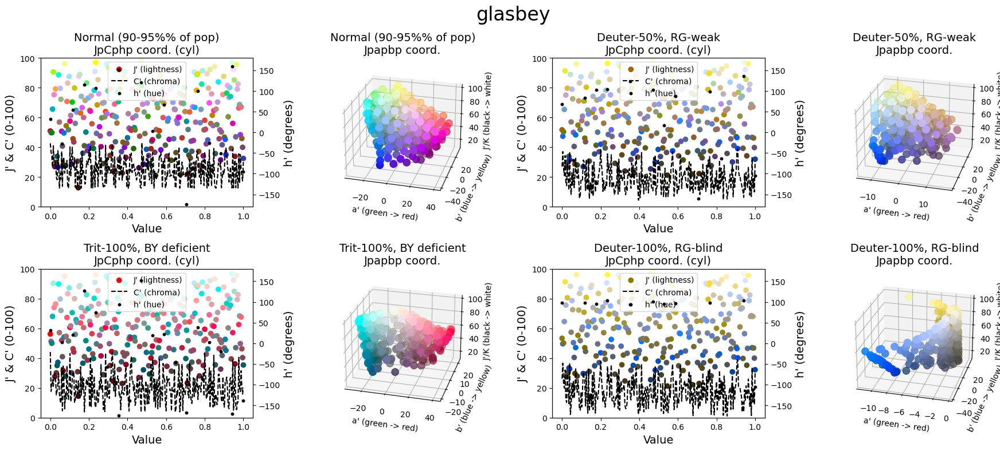

In [14]:
q_map = sc.ScicoQualitative(cmap="glasbey")
f = q_map.assess_cmap()
q_map.uniformize_cmap(lift=40)
f = q_map.assess_cmap()
# q_map.unif_sym_cmap(lift=None, bitonic=False, diffuse=False)

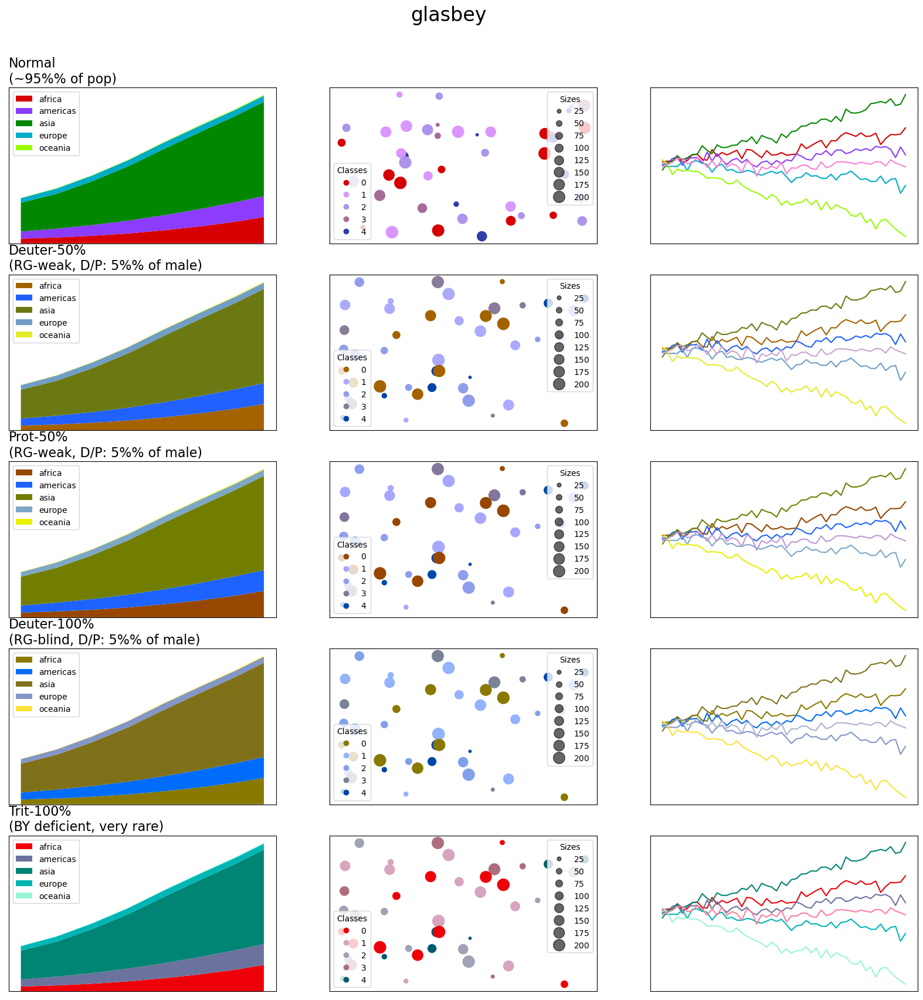

In [15]:
f = q_map.draw_example(facecolor="white")

## Illustrate extreme values

Some color maps are especially useful to illustrate extremum values (lower and upper bounds of the range of values).

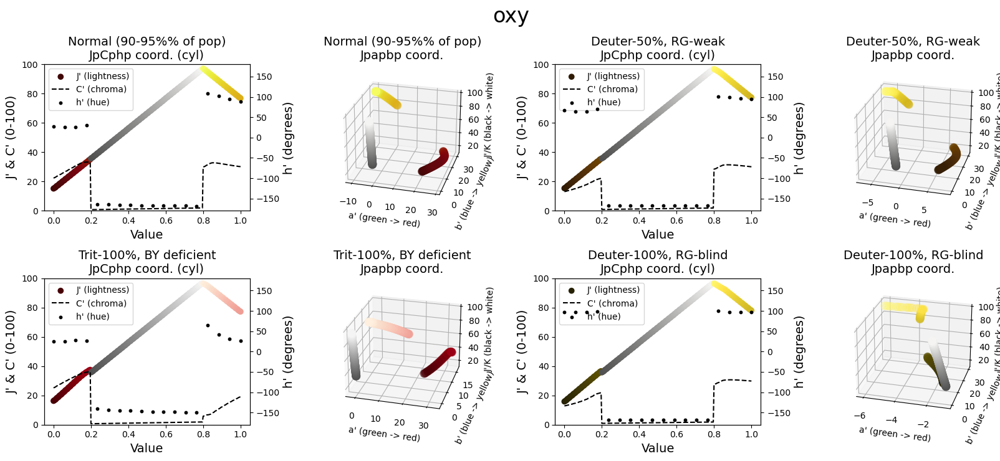

In [16]:
sc_map = sc.ScicoMiscellaneous(cmap="oxy")
# sc_map.unif_sym_cmap(lift=None, bitonic=True, diffuse=True)
f = sc_map.assess_cmap(figsize=figsize)

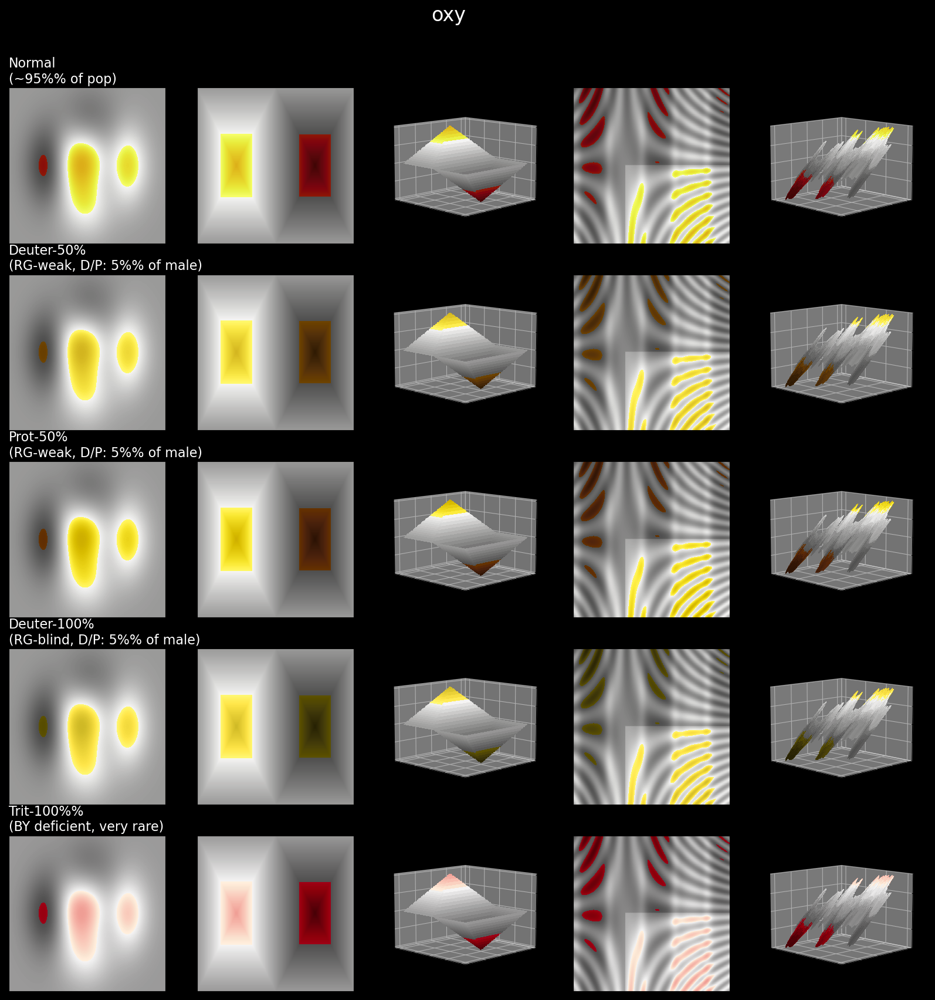

In [17]:
f = sc_map.draw_example()

## Comparing color maps
### Color-defiency rendering
Bearing in mind that +- 8% of males are color-deficient, you can visualize the rendering of any colormap for different kind of deficiencies.

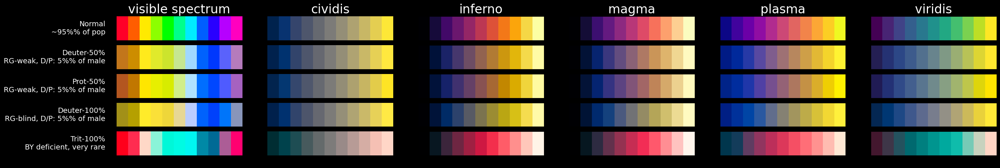

In [18]:
c_l =  ["cividis", "inferno", "magma", "plasma", "viridis"]
f = sc.plot_colorblind_vision(ctype='sequential', cmap_list=c_l, figsize=(30, 4), n_colors=11, facecolor="black")

### Rendering all sequential color maps

The built-in picture is coming from [First M87 Event Horizon Telescope Results. IV.
Imaging the Central Supermassive Black Hole](https://arxiv.org/ftp/arxiv/papers/1906/1906.11241.pdf) as the main part of Scicomap is built upon the EHT visualization library.

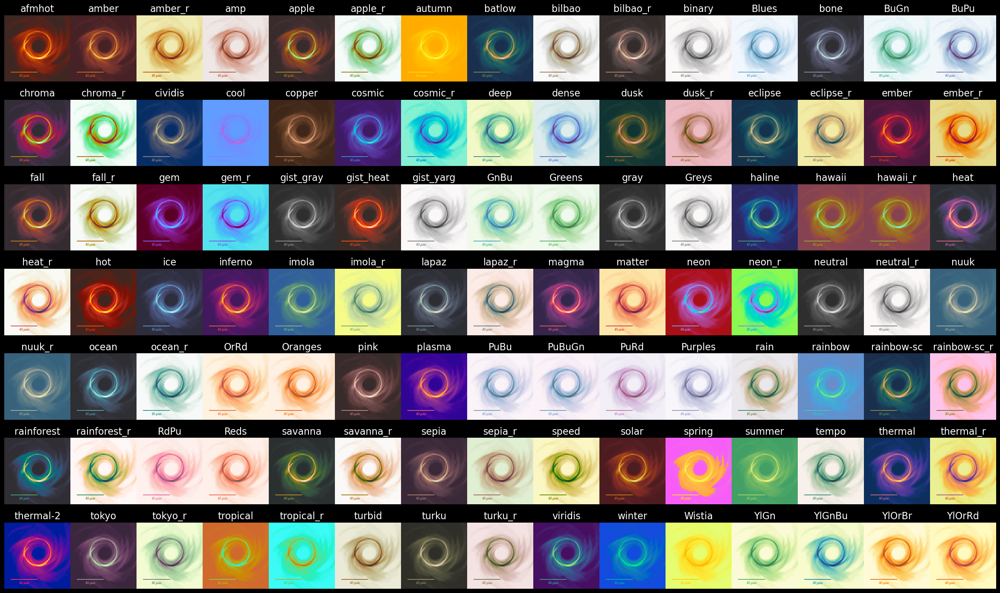

In [19]:
f = sc.compare_cmap(image="grmhd", 
                    ctype='sequential', 
                    ncols=15, 
                    uniformize=True, 
                    symmetrize=True, 
                    unif_kwargs={'lift': 20}, 
                    sym_kwargs={'bitonic': False, 'diffuse': True})

Comparing the diverging color maps using a vortex image

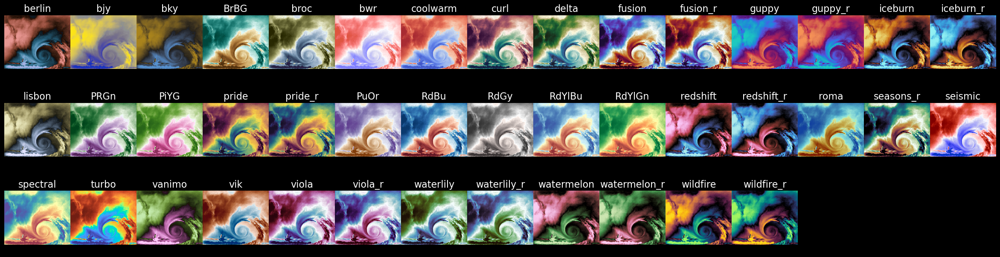

In [20]:
f = sc.compare_cmap(image="vortex", 
                    ctype='diverging', 
                    ncols=15, 
                    uniformize=True, 
                    symmetrize=True, 
                    unif_kwargs={'lift': None}, 
                    sym_kwargs={'bitonic': False, 'diffuse': True})

Comparing circular/phase color maps using a complex valued function

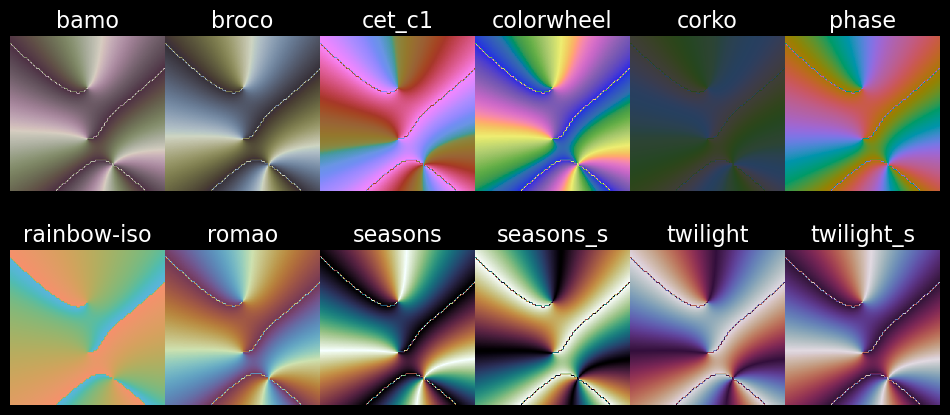

In [23]:
f = sc.compare_cmap(image="phase", 
                    ctype='circular', 
                    ncols=6, 
                    uniformize=True, 
                    symmetrize=True, 
                    unif_kwargs={'lift': None}, 
                    sym_kwargs={'bitonic': False, 'diffuse': True})

## All the color maps
### Sequential

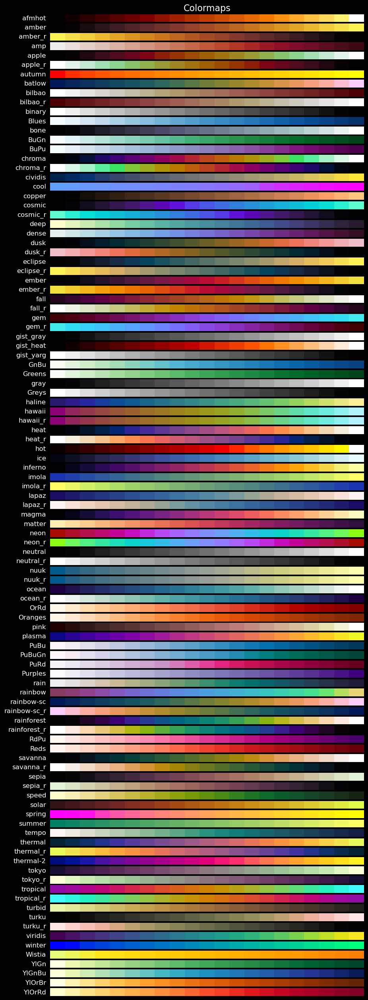

In [30]:
f=sc.plot_colormap(ctype='sequential', 
                cmap_list='all', 
                figsize=None, 
                n_colors=21, 
                facecolor="black", 
                uniformize=True, 
                symmetrize=False, 
                unif_kwargs=None, 
                sym_kwargs=None)

Diverging

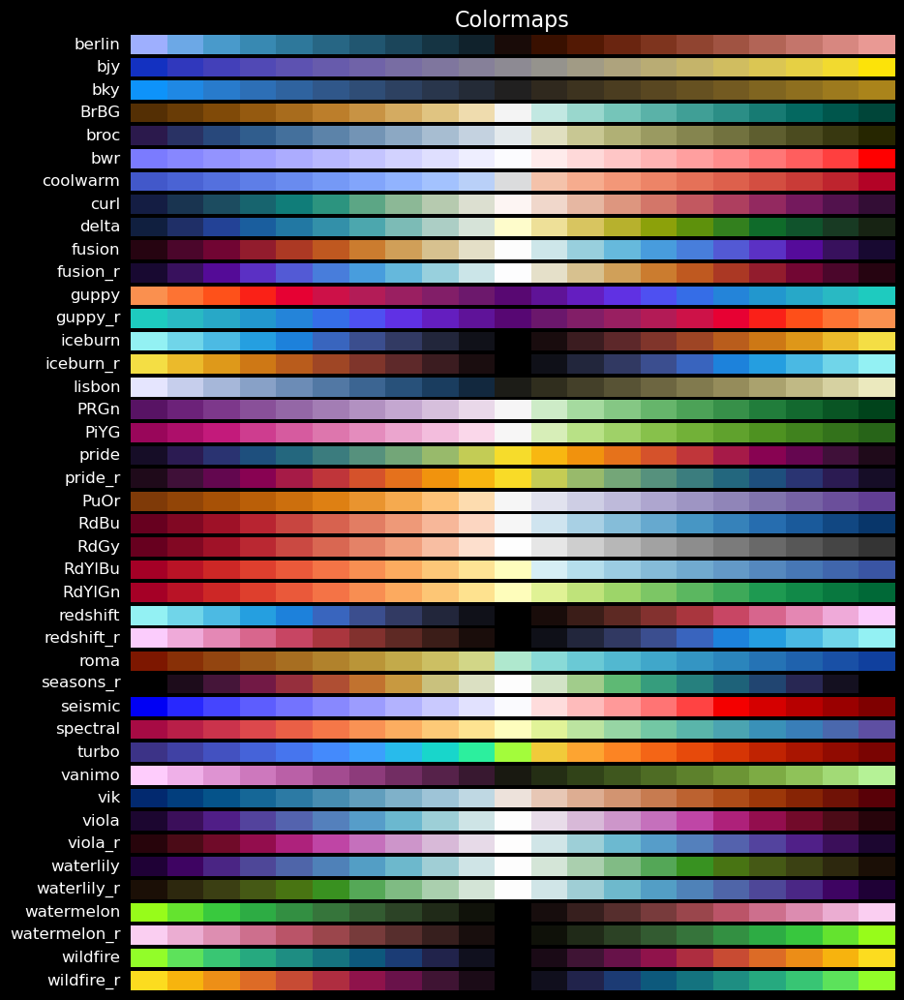

In [31]:
f=sc.plot_colormap(ctype='diverging', 
                cmap_list='all', 
                figsize=None, 
                n_colors=21, 
                facecolor="black", 
                uniformize=True, 
                symmetrize=False, 
                unif_kwargs=None, 
                sym_kwargs=None)

## Multi-squential

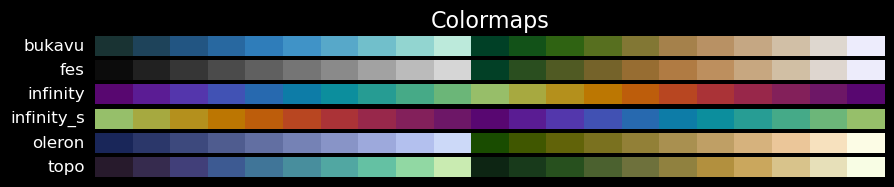

In [32]:
f=sc.plot_colormap(ctype='multi-sequential', 
                cmap_list='all', 
                figsize=None, 
                n_colors=21, 
                facecolor="black", 
                uniformize=True, 
                symmetrize=False, 
                unif_kwargs=None, 
                sym_kwargs=None)

## Miscellaneous

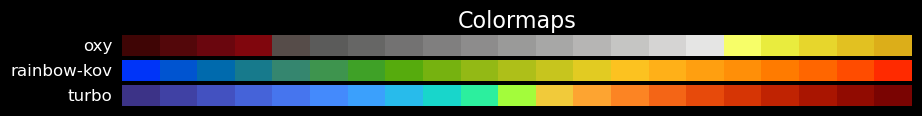

In [33]:
f=sc.plot_colormap(ctype='miscellaneous', 
                cmap_list='all', 
                figsize=None, 
                n_colors=21, 
                facecolor="black", 
                uniformize=True, 
                symmetrize=False, 
                unif_kwargs=None, 
                sym_kwargs=None)

## Qualitative

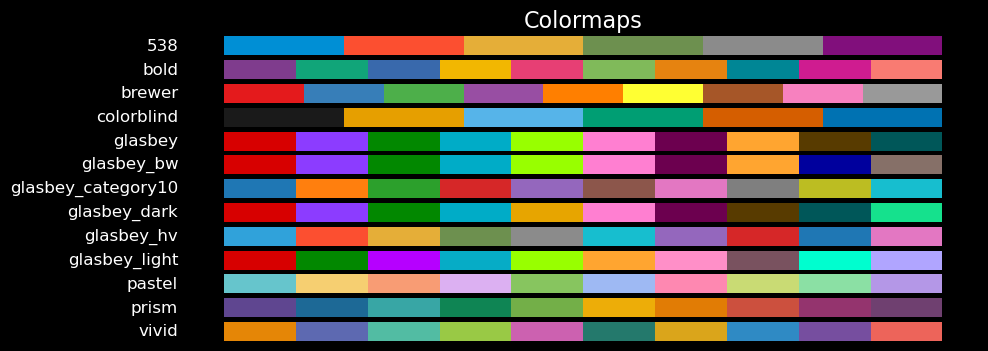

In [37]:
f=sc.plot_colormap(ctype='qualitative', 
                cmap_list='all', 
                figsize=None, 
                n_colors=10, 
                facecolor="black", 
                uniformize=False, 
                symmetrize=False, 
                unif_kwargs=None, 
                sym_kwargs=None)